# bars_metrics

In [1]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.colors as colors
import glob

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

In [2]:
folder = 'Z:\\1.Data\\Honduras\\transformed\\monthly_agg\\'
feature = 'prec'
#output_path='Z:\\1.Data\\Honduras\\results\\metrics\\'
#overall_file='metrics_overall.csv'
#monthly_file='metrics_monthly.csv'

In [3]:
def read_files(path_folder:str,
               feature
              )-> list:
    """
    function to identify the files of the observed stations and satellite data.

    Args:
        path_folder(str): Folder path
        feature(str): feature to read
    Returns:
        (list) : Lists with all concatenated files. 
        The first list corresponds to the observed data files and the second to the satellite data files.

    """
    filenames = glob.glob(
        path_folder + "/*.csv"
    )
    files_feat = [s for s in filenames if feature in s]
    obs_stations_file = [s for s in files_feat if 'obs' in s]
    satellites_file = [i for i in set(files_feat) if i not in obs_stations_file]
    return obs_stations_file, satellites_file 

def fun_get_data_grid(folder,
                      feature
                     )-> pd.DataFrame:
    """
    function to read data from both satellite and station files

    Args:
        path_folder(str): Folder path
        feature(str): feature to read
    Returns:
        df_stations(df) : dataframe with station data
        data_grid(df) :dataframe with satellital data
    """
    station_data, grid_data = read_files(folder, feature)
    df_stations = pd.read_csv(
        station_data[0]
    ).rename(
        columns={'Unnamed: 0':'date'}
    )
    df_stations['date'] = pd.to_datetime(df_stations['date'])
    df_stations.set_index('date', inplace=True)
    df_stations['source'] = 'obs_stations'
    
    data_grid = pd.DataFrame()
    for file in grid_data:
        df_gridded = pd.read_csv(file).rename(
            columns={'Unnamed: 0':'date'}
        )
        df_gridded['date'] = pd.to_datetime(df_gridded['date'])
        df_gridded.set_index('date', inplace=True)
        name = file[file.find(folder) + len(folder):file.find(feature)-1]
        df_gridded['source'] = name
        data_grid = pd.concat(
            [data_grid, df_gridded],
            axis=0
        )
    return df_stations, data_grid


def tendency(ref_comm, comparison_comm, source, column, feature):
    
    plt.scatter(ref_comm, comparison_comm)

    # Encontrar la línea de mejor ajuste
    m, b = np.polyfit(ref_comm, comparison_comm, 1)
    # Calcular el coeficiente de correlación
    r2 = np.corrcoef(ref_comm, comparison_comm)[0, 1]

    # Añadir la línea de mejor ajuste al scatterplot y agregar la ecuación a la leyenda
    plt.plot(ref_comm, m*ref_comm + b, color='red', label=f'y = {m:.2f}x + {b:.2f},\n R² = {r2:.2f}')

    # Agregar etiquetas y título al gráfico
    plt.xlabel('obs_stations')
    plt.ylabel(f'{source}')
    plt.title(f'Trend between {source} satellite data and observed data for the station {column}')
    # Fijar los límites del eje x
    if feature =='prec':
        plt.xlim(0, 450)
        plt.ylim(0, 450)
    if feature != 'prec':
        plt.xlim(0, 30)
        plt.ylim(0, 30)
    # Mostrar la leyenda y el gráfico
    plt.legend(loc='center right', bbox_to_anchor=(1.4, 0.5))
    plt.show()
    

In [4]:
df_stations, df_gridded = fun_get_data_grid(folder, feature)

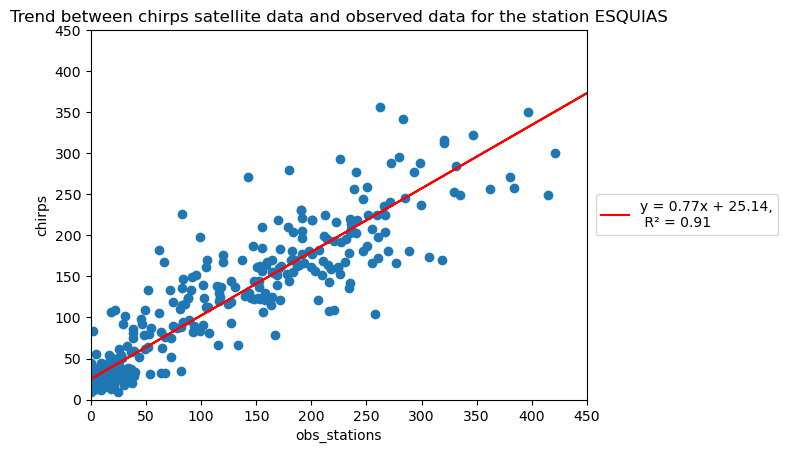

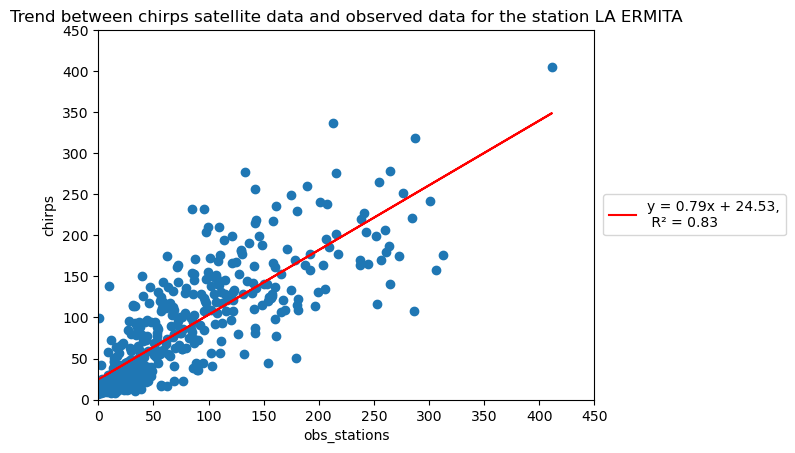

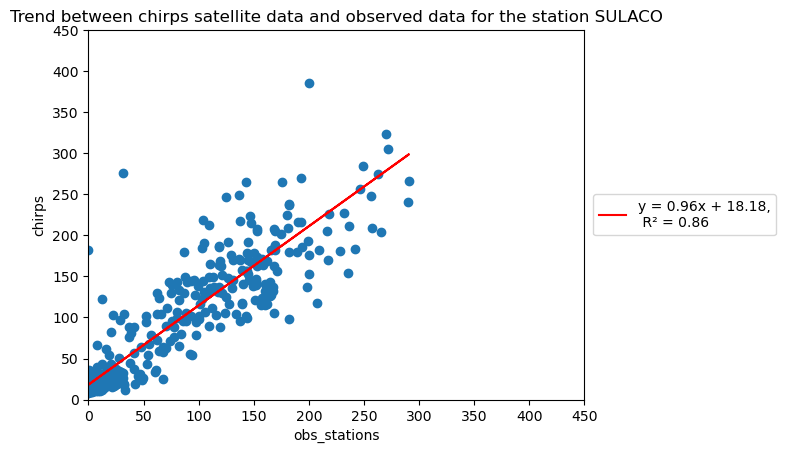

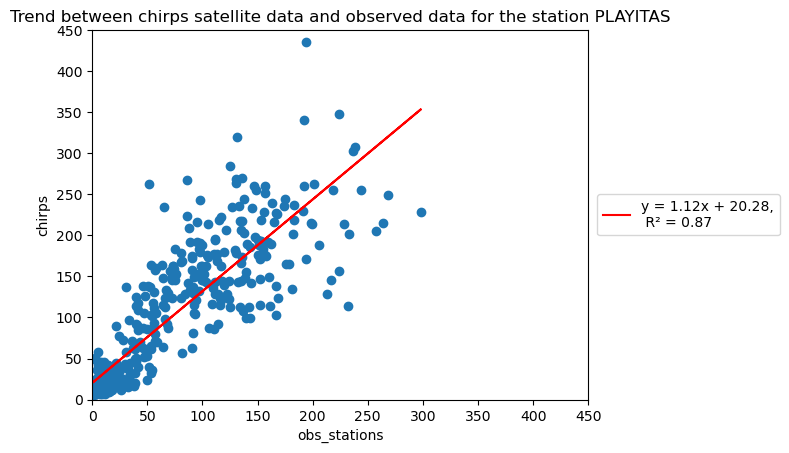

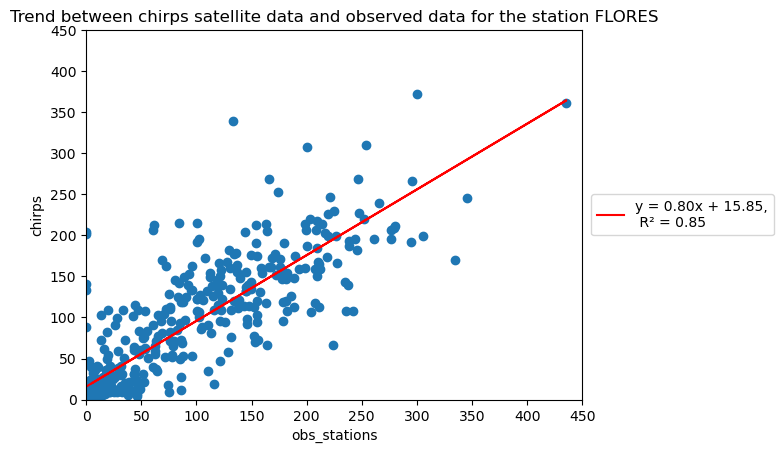

...

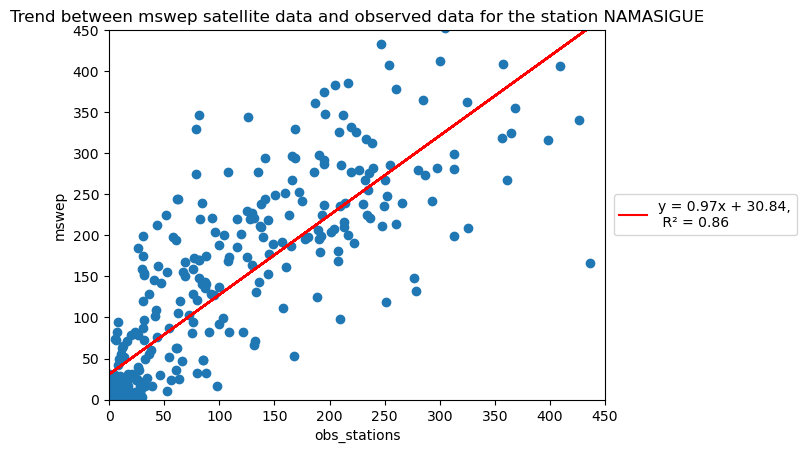

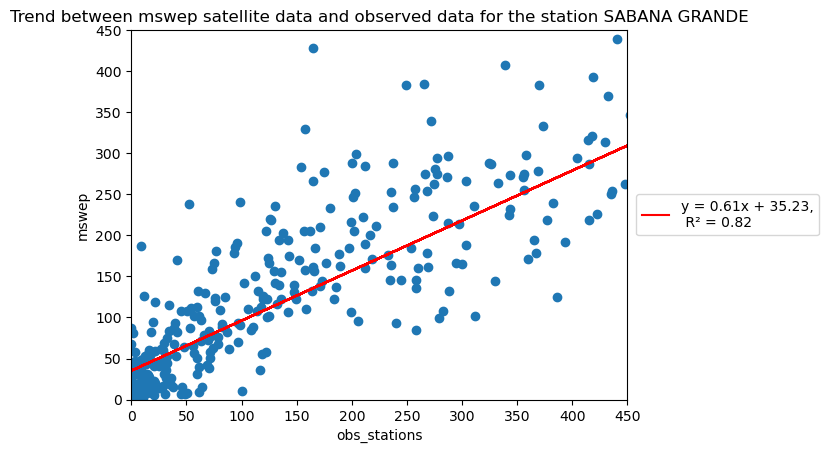

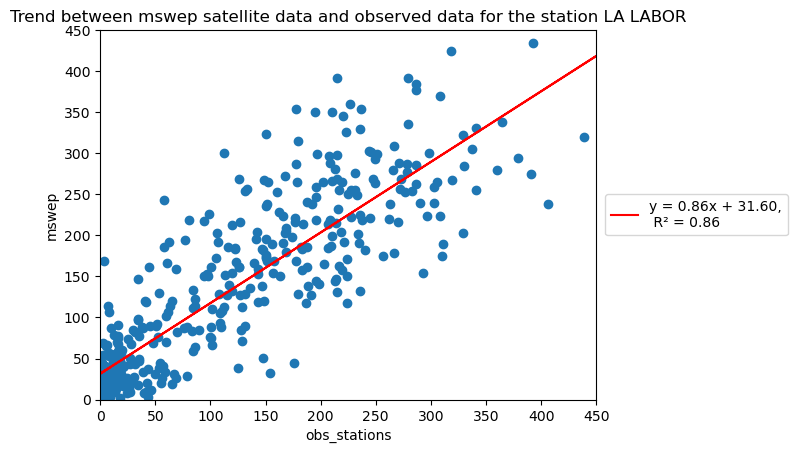

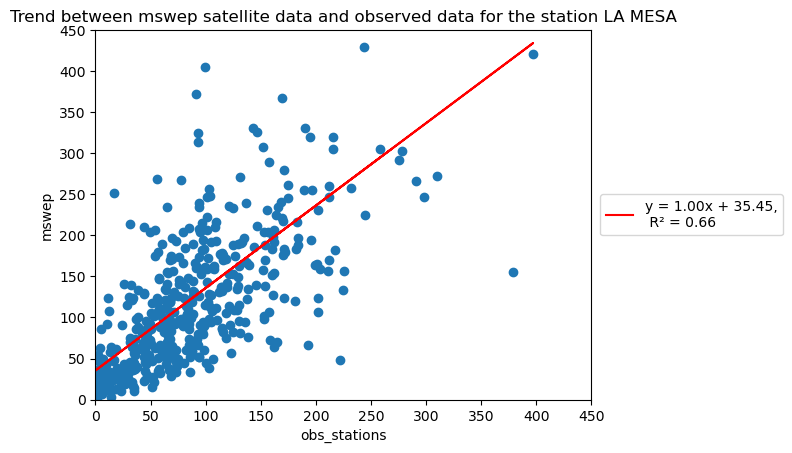

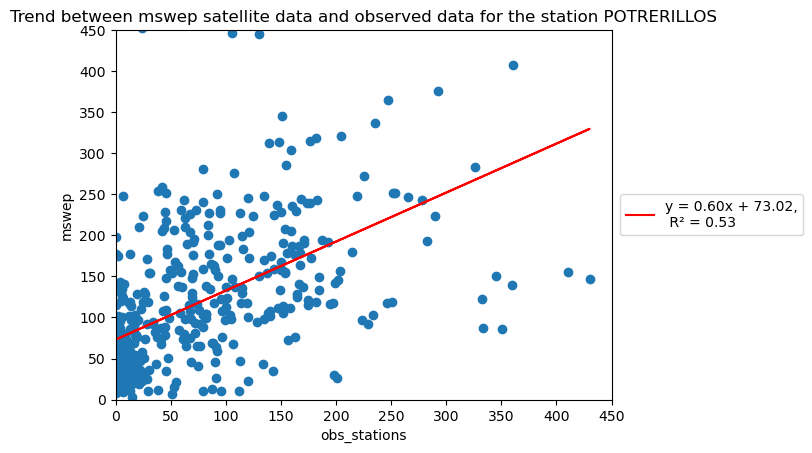

In [5]:
for source in df_gridded.source.unique():
    for column in df_stations.columns[:-2]:
        ref = df_stations[column].dropna()
        comparison = df_gridded[df_gridded.source==source][column].dropna()
        common_dates = ref.index.intersection(comparison.index).to_list()
        if len(common_dates)!=0:
            ref_comm = ref.loc[common_dates]
            comparison_comm = comparison.loc[common_dates]
            tendency(ref_comm, comparison_comm, source, column, feature)

# r10

In [6]:
feature2 = 'r10'
df_stations, df_gridded = fun_get_data_grid(folder, feature2)

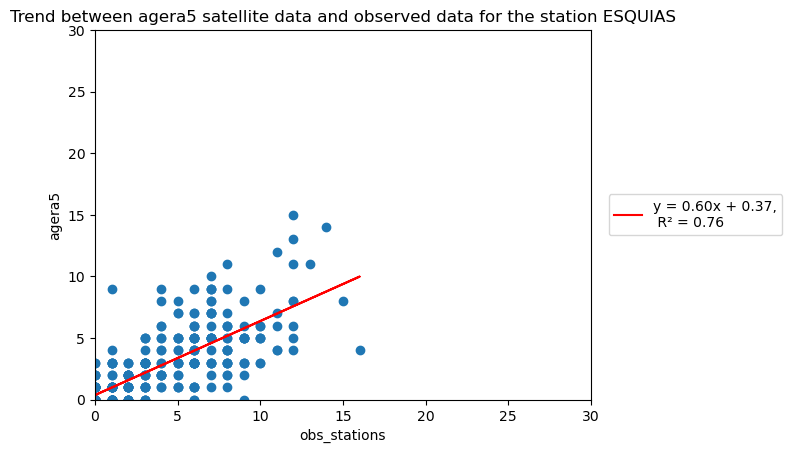

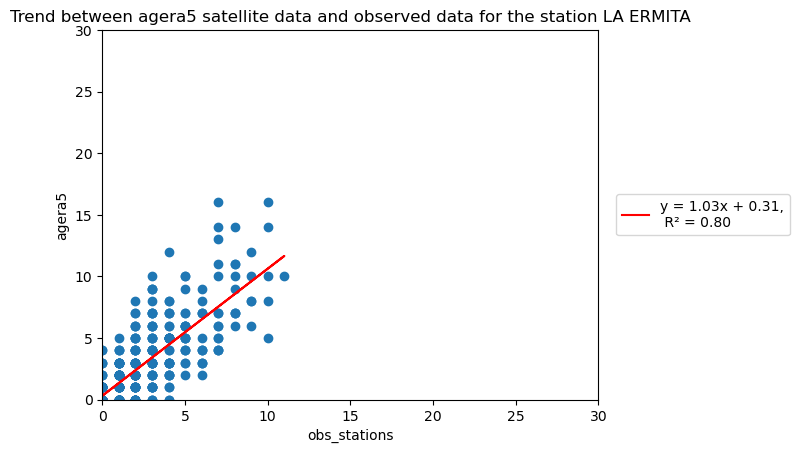

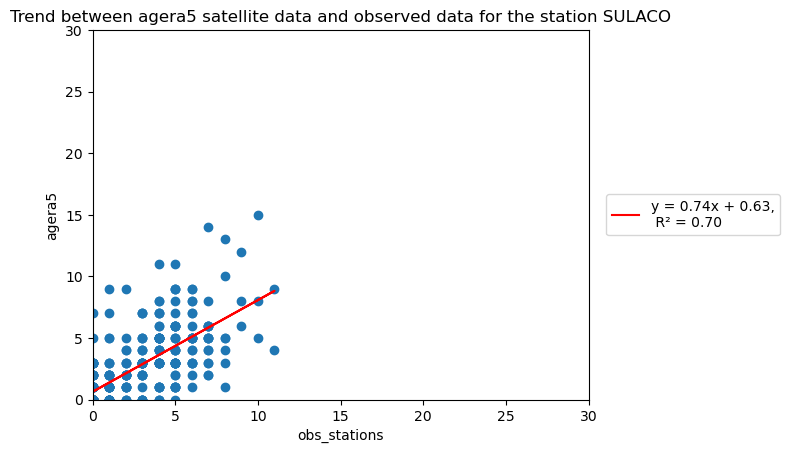

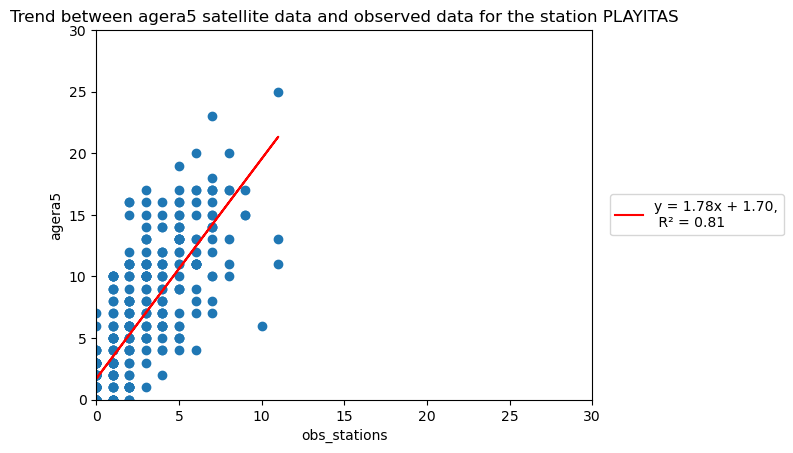

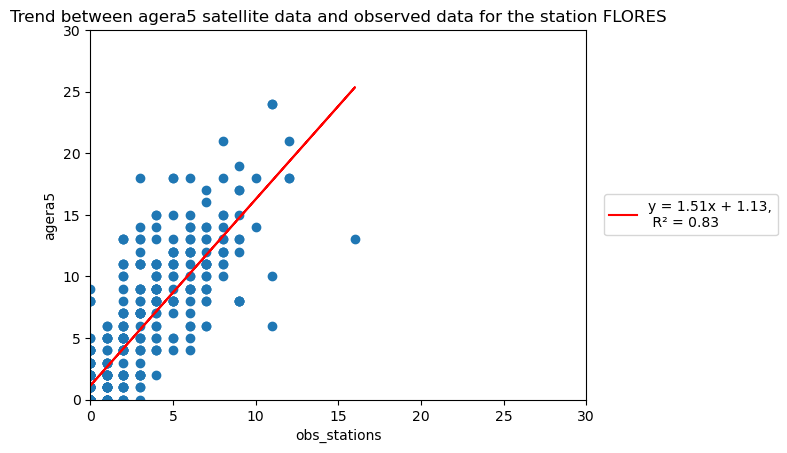

...

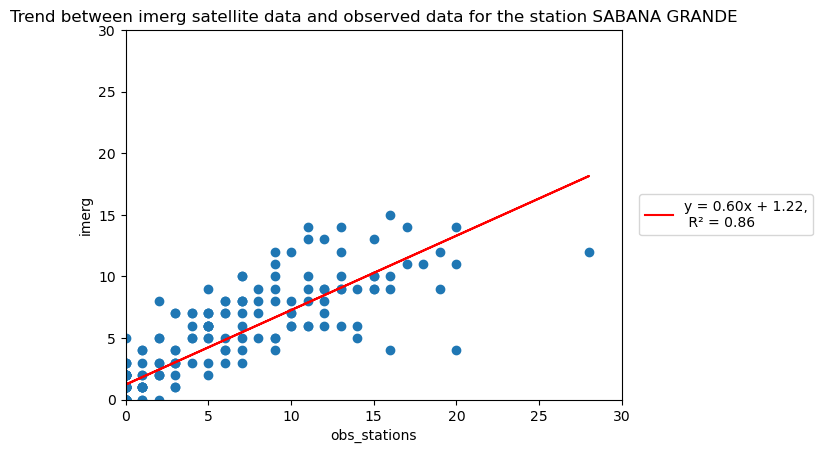

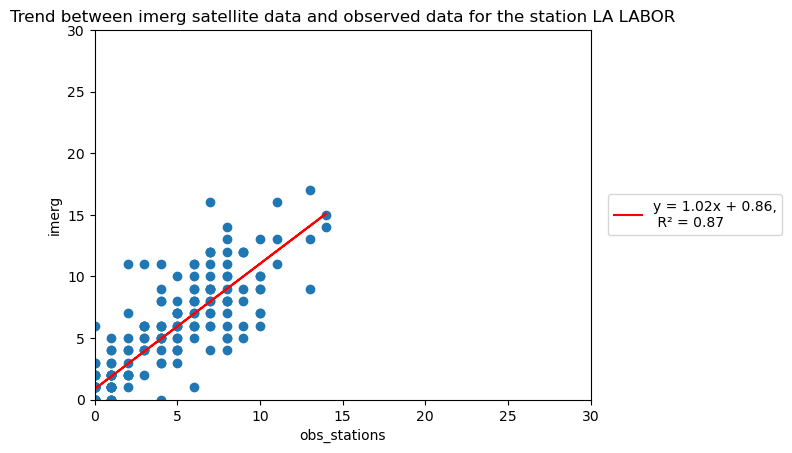

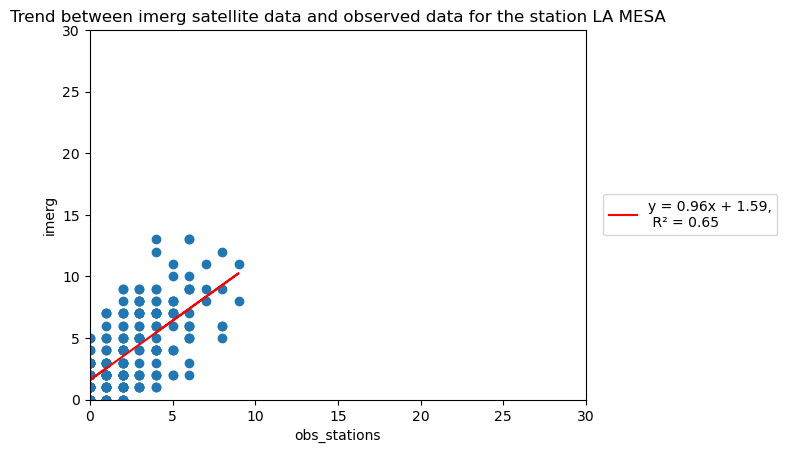

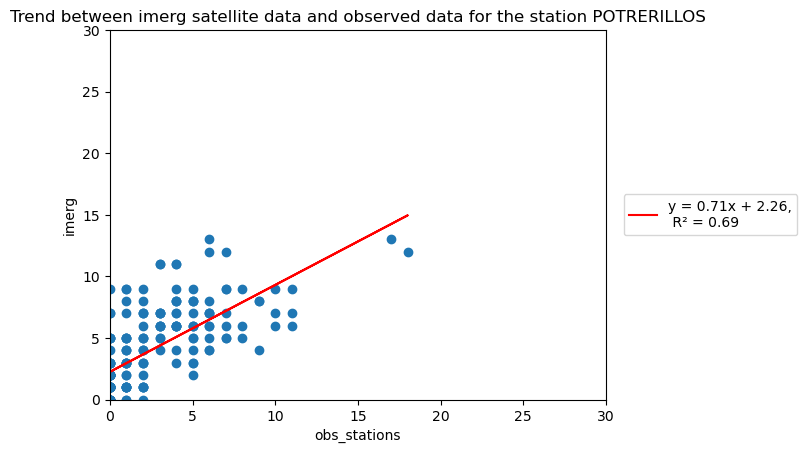

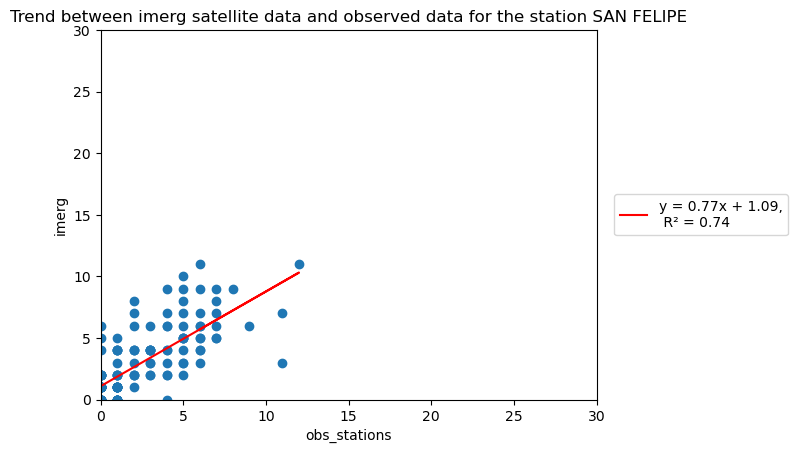

In [7]:
for source in df_gridded.source.unique():
    for column in df_stations.columns[:-1]:
        ref = df_stations[column].dropna()
        comparison = df_gridded[df_gridded.source==source][column].dropna()
        common_dates = ref.index.intersection(comparison.index).to_list()
        if len(common_dates)!=0:
            ref_comm = ref.loc[common_dates]
            comparison_comm = comparison.loc[common_dates]
            tendency(ref_comm, comparison_comm, source, column, feature2)

# r15

In [8]:
feature3 = 'r15'
df_stations, df_gridded = fun_get_data_grid(folder, feature3)

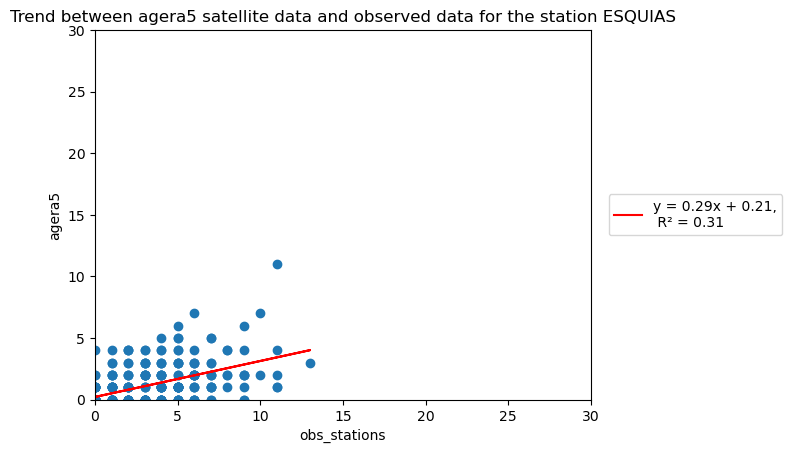

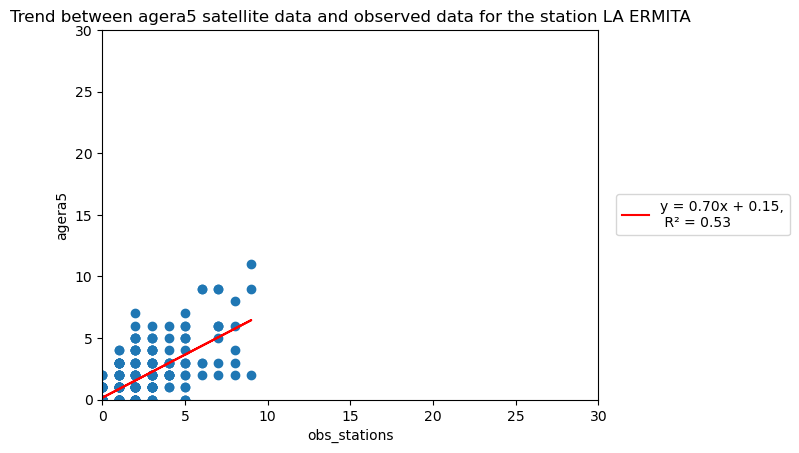

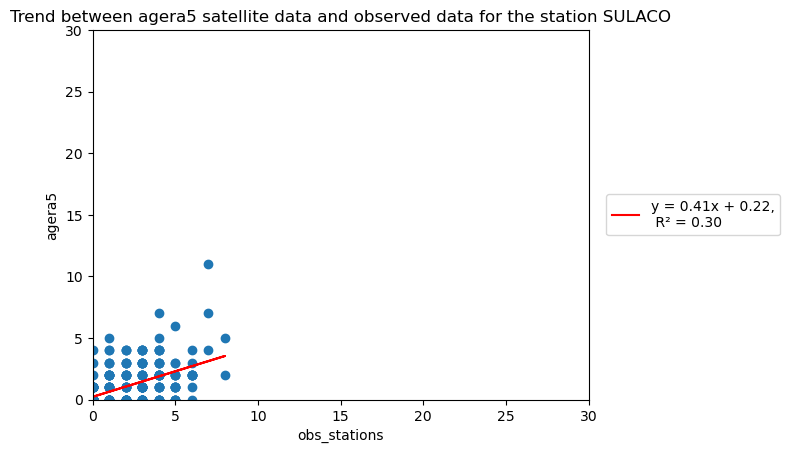

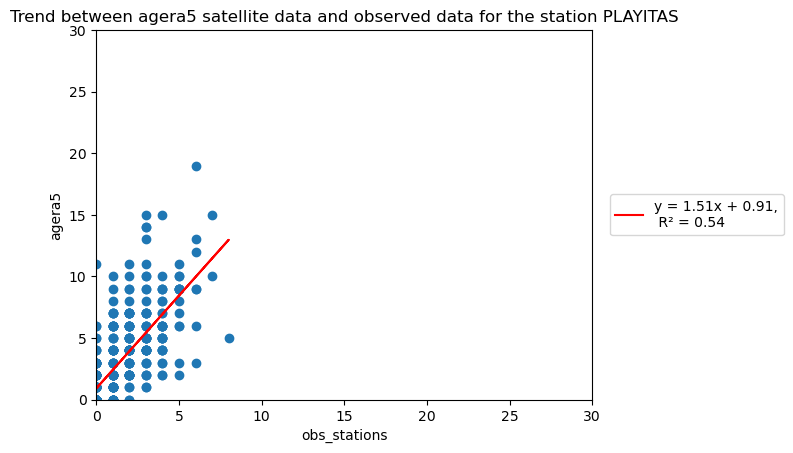

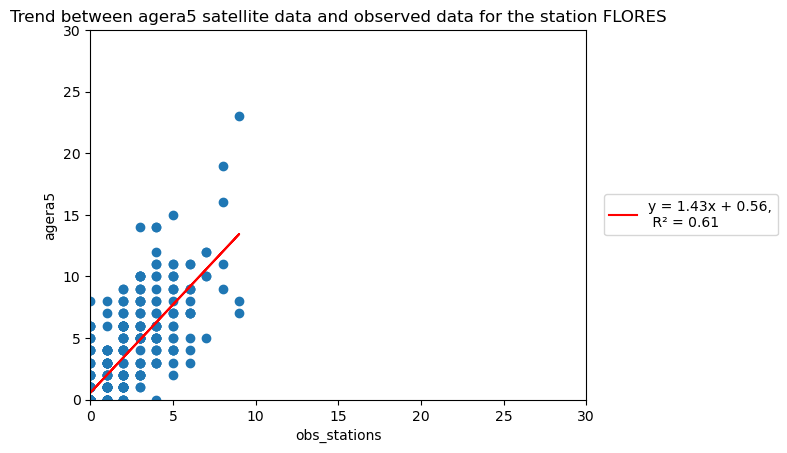

...

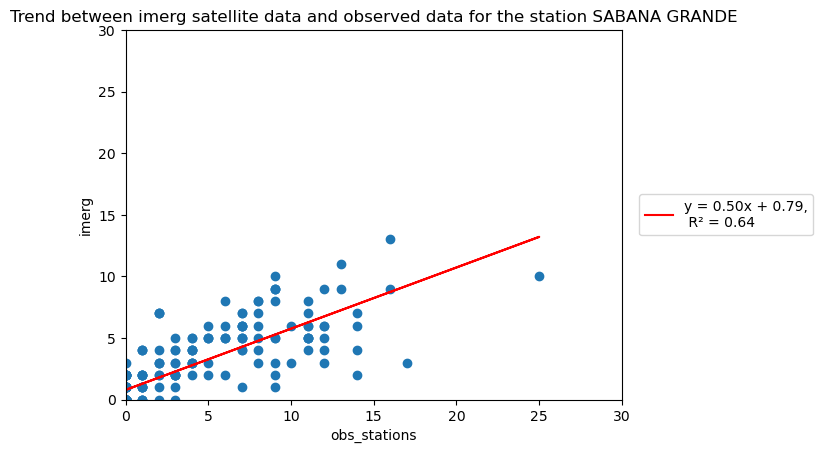

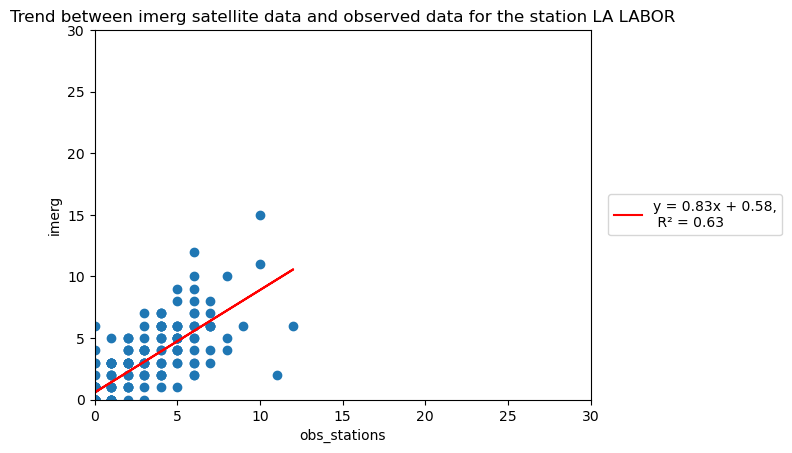

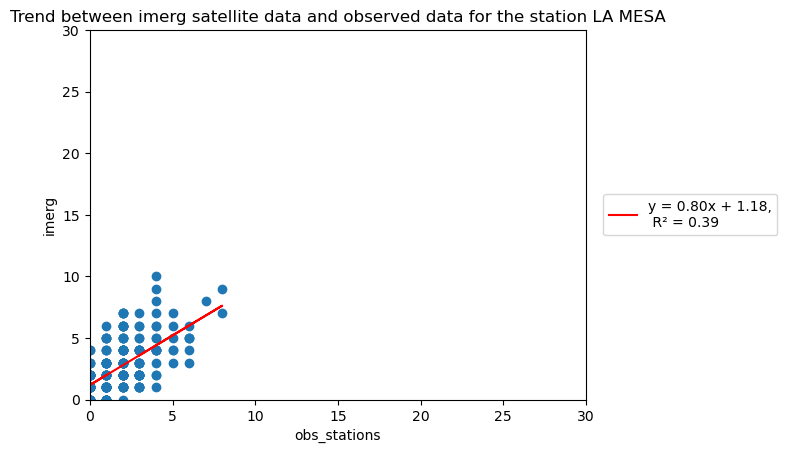

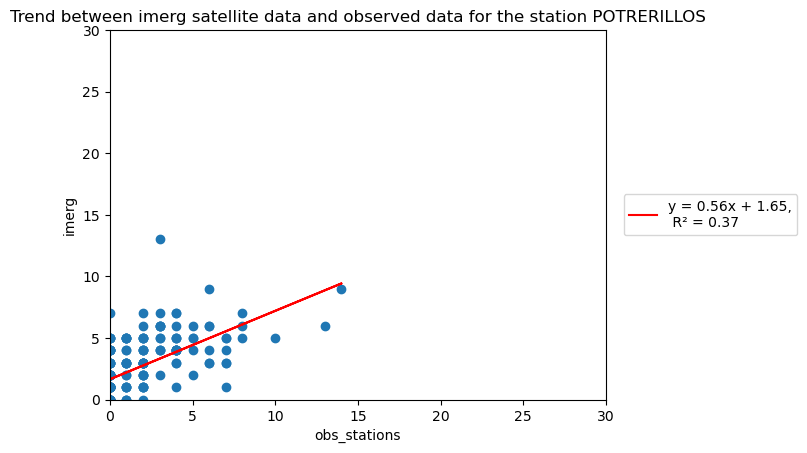

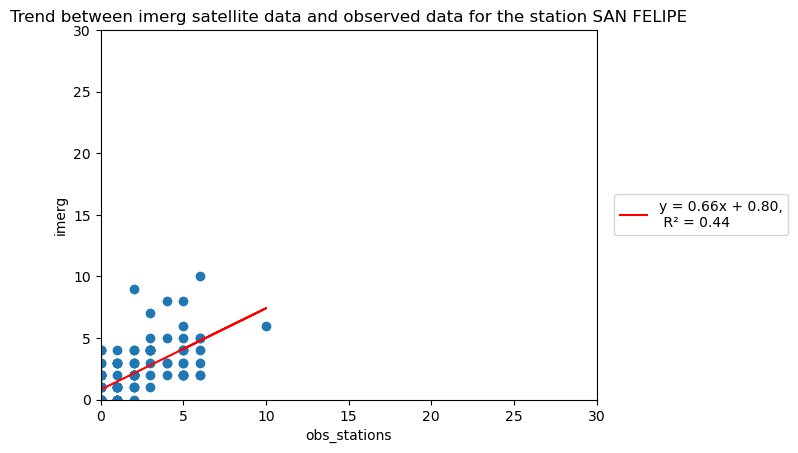

In [9]:
for source in df_gridded.source.unique():
    for column in df_stations.columns[:-1]:
        ref = df_stations[column].dropna()
        comparison = df_gridded[df_gridded.source==source][column].dropna()
        common_dates = ref.index.intersection(comparison.index).to_list()
        if len(common_dates)!=0:
            ref_comm = ref.loc[common_dates]
            comparison_comm = comparison.loc[common_dates]
            tendency(ref_comm, comparison_comm, source, column, feature3)